# Lab 02, Exercise 1: Bike Hires Usage in London in Python

London has a bike hire scheme with over 600 docking stations. We collect data of how many bikes are available to rent at each docking station. Assuming that changes in use reflect use by customers we can analyse it to get an insight of how people use the bike scheme in London.

This notebook loads 24h of bike data where data has been collected every 10min (last 24h of data from https://staff.city.ac.uk/~sbbb717/tfl_bikes/last24h.php - **please don't share**).

We will explore this Python.

We will load and do some initial tranformations of the data in Python.

In [1]:
import pandas as pd

Load the bike stations.

In [2]:
stations=pd.read_csv("bikeStations.tsv",sep="\t")
stations.head()

,id,name,lat,lon
0,1,"River Street , Clerkenwell",51.529163,-0.109971
1,2,"Phillimore Gardens, Kensington",51.499607,-0.197574
2,3,"Christopher Street, Liverpool Street",51.521284,-0.084606
3,4,"St. Chad's Street, King's Cross",51.530059,-0.120974
4,5,"Sedding Street, Sloane Square",51.493130,-0.156876


Load the last 24h of data (download from the link above, name the file and copy into your working directory). You can replace the one supplied (which won't be as up-to-date).

In [3]:
last24=pd.read_csv("last24h.csv")
last24.head()

,stationId,availableBikes,availableDocks,t
0,1,1,18,2025-10-06 12:00:01
1,2,0,35,2025-10-06 12:00:01
2,3,31,0,2025-10-06 12:00:01
3,4,12,10,2025-10-06 12:00:01
4,5,26,0,2025-10-06 12:00:01


Merge the two files so that we have station names and locations.

In [4]:
data=pd.merge(last24,stations,left_on='stationId',right_on='id')
data.head()

,stationId,availableBikes,availableDocks,t,id,name,lat,lon
0,1,1,18,2025-10-06 12:00:01,1,"River Street , Clerkenwell",51.529163,-0.109971
1,1,1,18,2025-10-06 12:10:01,1,"River Street , Clerkenwell",51.529163,-0.109971
2,1,1,18,2025-10-06 12:20:01,1,"River Street , Clerkenwell",51.529163,-0.109971
3,1,1,18,2025-10-06 12:30:01,1,"River Street , Clerkenwell",51.529163,-0.109971
4,1,1,18,2025-10-06 12:40:01,1,"River Street , Clerkenwell",51.529163,-0.109971


Convert the time to a time object

In [5]:
data['t']=pd.to_datetime(data['t'])

Extract the hour and calculate the capacity.

In [6]:
data['hr']=data['t'].dt.hour
data['capacity']=data["availableBikes"]+data["availableDocks"]

## Hourly summary


Data every 10mins over 4h is quite a lot, so let's group summarise it hourly. We will group by station and hour (and all the columns we want to keep) and Calculate the mean number of bikes per hour per station.

In [7]:
grouped=data.groupby(by=["id","name","hr","capacity","lat","lon"])
hourlyBike=grouped.aggregate({"availableBikes":"mean"}).reset_index()
hourlyBike.head()

,id,name,hr,capacity,lat,lon,availableBikes
0,1,"River Street , Clerkenwell",0,19,51.529163,-0.109971,12.0
1,1,"River Street , Clerkenwell",1,19,51.529163,-0.109971,12.0
2,1,"River Street , Clerkenwell",2,19,51.529163,-0.109971,12.0
3,1,"River Street , Clerkenwell",3,19,51.529163,-0.109971,12.0
4,1,"River Street , Clerkenwell",4,19,51.529163,-0.109971,12.0


## Demonstrate pivoting/melting

We will now transporm the data into a "wide" format and then back into a "long" format, just to illustrate how to do it and what the difference in structure is.

This code (below) transforms into a "wide" format, pivoting the hour column into one column for each hour.

_The `reset_index()` removes columns from the index. `wideBike.columns=wideBike.columns.astype(str)` is used change the column names to the string type which helps us later - only necessary because the hours are currently integers_

In [8]:
wideBike=hourlyBike.pivot(index=["id","name","lat","lon","capacity"],columns="hr", values="availableBikes").reset_index()
wideBike.columns=wideBike.columns.astype(str)

Just to show how to do is, this transport back to the original "long" format.

In [9]:
longBike=pd.melt(wideBike, id_vars=["id","name","lat","lon","capacity"],value_name="availableBikes").reset_index()
longBike

,index,id,name,lat,lon,capacity,hr,availableBikes
0,0,1,"River Street , Clerkenwell",51.529163,-0.109971,18,0,NaN
1,1,1,"River Street , Clerkenwell",51.529163,-0.109971,19,0,12.0
2,2,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,35,0,NaN
3,3,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,36,0,7.5
4,4,3,"Christopher Street, Liverpool Street",51.521284,-0.084606,31,0,NaN
...,...,...,...,...,...,...,...,...
42019,42019,817,"Riverlight South, Nine Elms",51.481335,-0.138212,25,23,NaN
42020,42020,817,"Riverlight South, Nine Elms",51.481335,-0.138212,26,23,26.0
42021,42021,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,22,23,NaN
42022,42022,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,23,23,NaN


In [10]:
wideBike.to_csv("bikeHourlyWide.csv",index=False)
longBike.to_csv("bikeHourlyLong.csv",index=False)

## Task 2.1: Use MatPlotLib to plot superimpose a 24h timeline for each bike

MatPlotLib is a basic plotting library where you give it arrays/list and it plots them. The "wide" format is most suitable because we need a column for each station.

Like Excel, MatPlotLib doesn't expect "tidy" data. It expects a column for each data series. Here, we give MatPlotLib a 2D array of a table with each bike station as columns and the hours of the day as rows. We had to use transpose() to transpose the columns/rows.

_ The `wideBike.loc[:, '0':'22']` selects all the rows and the column named "0" to the column named "23" (the number of 24 hours)

_Tip: the semicolon at the end suppresses the data series output - try omitting it)
 

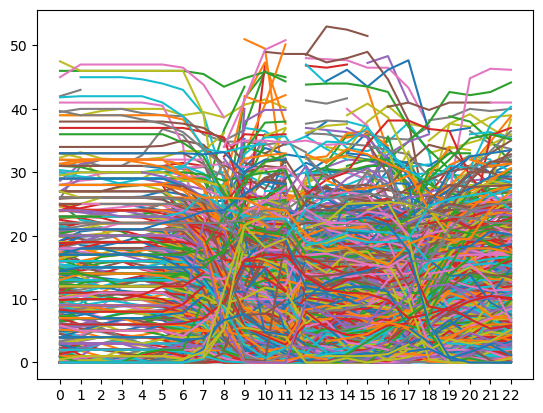

In [11]:
import matplotlib.pyplot as plt

plt.plot(wideBike.loc[:, '0':'22'].transpose());

Questions:
    
 - Why did we use transpose()? What gets plotted if we didn't do that?
 - Improve the plot my making the lines more transparent (copy the code below and modify).
 - Improve the plot filtering on a subset of bike stations (copy the code below and modify).
 - Filter the stations on some of the regions (the bit after the comma); e.g. Kings Cross
 - normalise the lines so that they show the proportion of full (derive a new column that divides by the capacity).
 - What temporal patterns are evident ?
 - What do you think of the use of hue?


## Task 2.2: Use Altair to plot superimpose a 24h timeline for each bike

Altair requires tidy data in which every column is a variable and every row is an observation. So the long format is most suitable.
 

In [12]:
longBike

,index,id,name,lat,lon,capacity,hr,availableBikes
0,0,1,"River Street , Clerkenwell",51.529163,-0.109971,18,0,NaN
1,1,1,"River Street , Clerkenwell",51.529163,-0.109971,19,0,12.0
2,2,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,35,0,NaN
3,3,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,36,0,7.5
4,4,3,"Christopher Street, Liverpool Street",51.521284,-0.084606,31,0,NaN
...,...,...,...,...,...,...,...,...
42019,42019,817,"Riverlight South, Nine Elms",51.481335,-0.138212,25,23,NaN
42020,42020,817,"Riverlight South, Nine Elms",51.481335,-0.138212,26,23,26.0
42021,42021,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,22,23,NaN
42022,42022,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,23,23,NaN


Here, we calculate proportion full and also extract the *area* from the name. The `lamba` expression provides a function to Panda whicu it applies to every row of the `name` column.

In [13]:
longBike["propFull"]=longBike["availableBikes"]/longBike["capacity"]
longBike['area']=longBike['name'].apply(lambda v:v.split(",")[1])
longBike

,index,id,name,lat,lon,capacity,hr,availableBikes,propFull,area
0,0,1,"River Street , Clerkenwell",51.529163,-0.109971,18,0,NaN,NaN,Clerkenwell
1,1,1,"River Street , Clerkenwell",51.529163,-0.109971,19,0,12.0,0.631579,Clerkenwell
2,2,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,35,0,NaN,NaN,Kensington
3,3,2,"Phillimore Gardens, Kensington",51.499607,-0.197574,36,0,7.5,0.208333,Kensington
4,4,3,"Christopher Street, Liverpool Street",51.521284,-0.084606,31,0,NaN,NaN,Liverpool Street
...,...,...,...,...,...,...,...,...,...,...
42019,42019,817,"Riverlight South, Nine Elms",51.481335,-0.138212,25,23,NaN,NaN,Nine Elms
42020,42020,817,"Riverlight South, Nine Elms",51.481335,-0.138212,26,23,26.0,1.000000,Nine Elms
42021,42021,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,22,23,NaN,NaN,Bermondsey
42022,42022,818,"One Tower Bridge, Bermondsey",51.503128,-0.078656,23,23,NaN,NaN,Bermondsey


See the specification below. `:Q`, `:N` and `:O` tells Altair to treat variables as quantitative, nominal and ordinal. Opacity is set to 0.1.

 - What are the effects for changing these data type?
 - Ty changing the opacity
 - Try plotting proportion full.

In [14]:
import altair as alt

alt.data_transformers.disable_max_rows()

alt.Chart(longBike).mark_line(opacity=0.1).encode(
    x='hr:Q',
    y='availableBikes:Q',
    color='id:N'
)

alt.Chart(...)

## Task 2.3: Use Altair to study spatial patterns

Maps where we map the stations can help us look for spatial pattern. Filtering or faceting on time can help see how these varies throughout the day.

See the map below.

 - Which visual variables are used and how effective are they?

_The `latitude` and `longitude` visual variables are like `x` and `y` but they take latitude and longitude and they transform them to a Mercator projection_

_`alt.data_transformers.disable_max_rows()` just allows Altair to use larger datasets._
 

In [15]:
import altair as alt

alt.data_transformers.disable_max_rows()

longBike["propFull"]=longBike["availableBikes"]/longBike["capacity"]

alt.Chart(longBike).mark_circle().encode(
    latitude='lat',
    longitude='lon',
    size='capacity',
    color='average(propFull)',
).properties(
    width=600
)

alt.Chart(...)

The above spec is a **shorthand** version of the spec.

To get more control, a more verbose version is needed - see below.

This diverging colour scheme - where the point of divergence is at half-full - clearly shows the spatial patterns of empty vs full docking stations. 

Notice also the `tooltip` which gives details on demand. Try using in other Altair specs.

 - Comment on the diverging colour scale and its use of hue and lightness.
 - Note that it average across the whole day. Filter it on one or more hours using Panda's filtering methods directly inline in the spec: e.g. `longBike[longBike.hr=="10"]` will filter on those with `hr` being 10
 - How useful is the tooltip?

In [16]:
 import altair as alt

alt.data_transformers.disable_max_rows()


alt.Chart(longBike).mark_circle().encode(
    alt.Latitude('lat'),
    alt.Longitude('lon'),
    alt.Size('capacity'),
    alt.Color('average(propFull)',scale=alt.Scale(scheme='redblue',domain=[0, 1])),
    tooltip=['name','area','average(propFull)']  
).properties(
    width=600
)

alt.Chart(...)

Finally, the example below facets the maps into 4 hour bins.
 - What spatio-temporal patterns do you observe?

In [17]:
 import altair as alt

alt.data_transformers.disable_max_rows()


alt.Chart(longBike).mark_circle().encode(
    alt.Latitude('lat'),
    alt.Longitude('lon'),
    alt.Facet("hr:O",bin=alt.Bin(step=4,nice=True),columns=3),
    alt.Color('average(propFull)',scale=alt.Scale(scheme='redblue',domain=[0, 1])),
)

alt.Chart(...)

## Task 2.4: Play with some gridded glyphmaps

Have a look at this [notebook](https://observablehq.com/d/05b119b94705f4bf#cell-717). It is an Observable notebook - whose language is JavaScript - that lets you explore the timeseries of docking stations in grid squares at multiple scales.